Using markers: ['CD185', 'CD62L', 'CD163', 'Ki67', 'CD366', 'PAX5', 'CD134', 'CD5', 'CD206', 'CD25', 'CD16', 'CD79a', 'CD34', 'CXCL13', 'CD21', 'CD7', 'Podoplanin', 'HLA-DR', 'CD223', 'CD20', 'CD56', 'CD45RO', 'CD278', 'CD90', 'CD4', 'CD11c', 'CD3', 'CD68', 'CD14', 'CD8', 'Kappa light chain', 'CD45RA', 'CD11b', 'Granzyme B', 'CD31', 'CD45', 'CD38', 'CD44', 'DRAQ5', 'DNA']
Samples: ['LN0251-007', 'LN0265-002', 'LN0265-003', 'LN0251-006']
Total cells: 29412, Markers: 40
Computing UMAP...
UMAP embedding shape: (29412, 2)


/tmp/ipykernel_35889/3898758611.py:88: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap(cmap)(np.linspace(0, 1, n_sids))


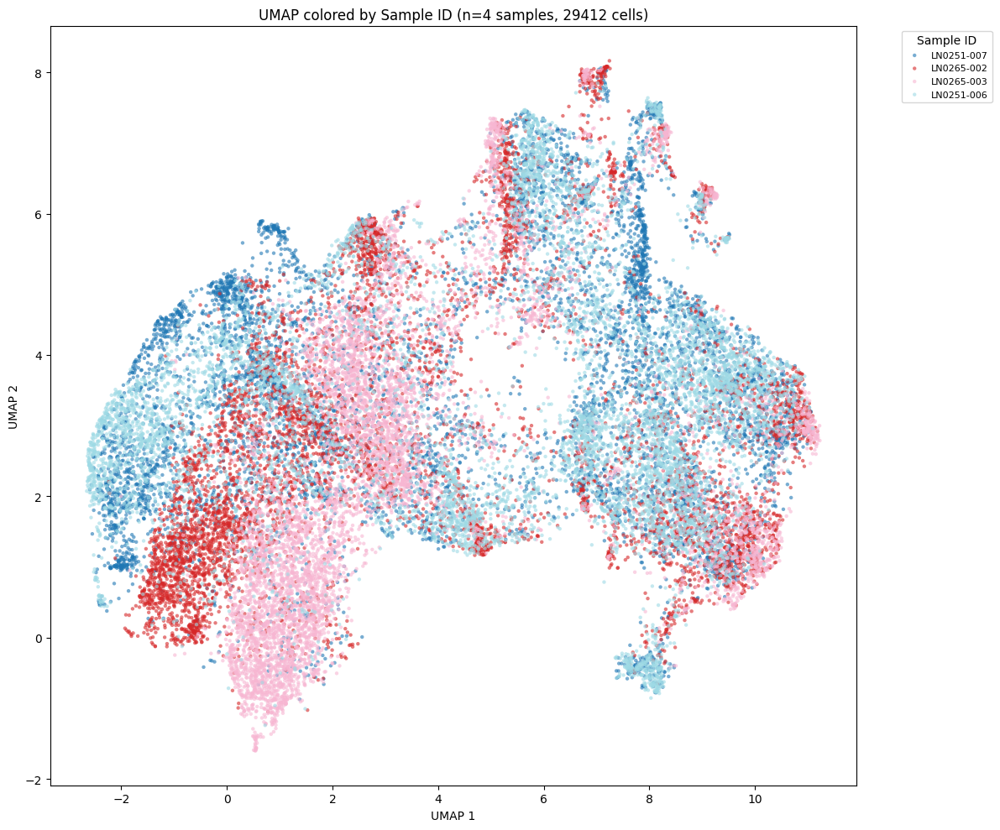

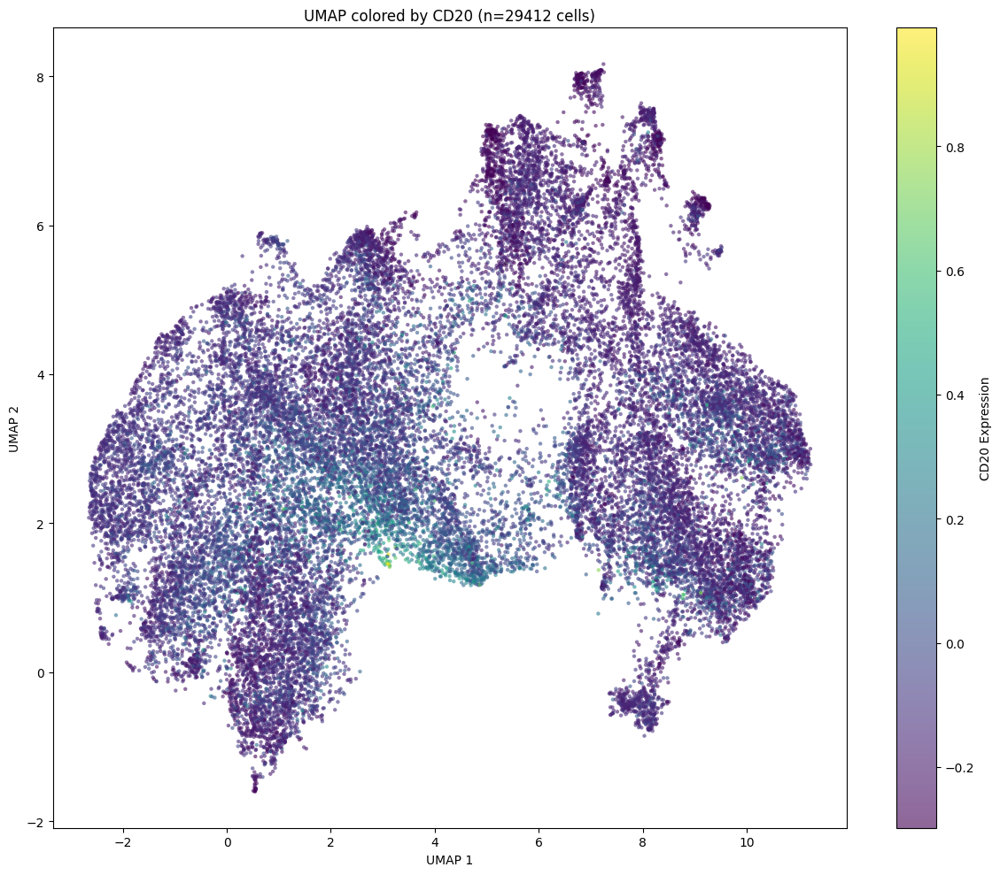

In [43]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
from umap import UMAP
import pandas as pd
from BioUtensils_package.BioUtensils.extraction import get_cell_expression_fast

# Load data (your existing code)
h5_filepath = '/home/simon_g/isilon_images_mnt/10_MetaSystems/MetaSystemsData/_simon/data/MCI_data/h5_files/CODEX_DLBCL2/CODEX_DLBCL2_with_norm_stats.h5'
used_markers = '/home/simon_g/isilon_images_mnt/10_MetaSystems/MetaSystemsData/_simon/data/MCI_data/h5_files/CODEX_DLBCL2/used_markers.txt'

with open(used_markers, 'r') as f:
    markers = [s.strip() for s in f.readlines()]
    
expressions_list = []
sids_list = []
all_sids = []

with h5py.File(h5_filepath, 'r') as h5f:
    marker_names = h5f['marker_names'][()].astype(str)
    keep_idx = [i for i in range(len(marker_names)) if marker_names[i] in markers]
    marker_names_filtered = [marker_names[i] for i in keep_idx]
    
    print(f"Using markers: {marker_names_filtered}")
    print(f"Samples: {list(h5f['sample_ids'][()].astype(str))}")
    
    for sid in h5f['sample_ids'][()].astype(str):
        W,H,C = h5f['data'][sid]['image'].shape
        image = h5f['data'][sid]['image'][W//2-500:W//2+500,H//2-500:H//2+500, keep_idx]
        masks = h5f['data'][sid]['masks'][W//2-500:W//2+500,H//2-500:H//2+500]
        
        #image = np.tanh((image - image.mean(axis=(0,1))) / (2.5 * image.std(axis=(0,1)))).transpose(2,0,1)
        
        expression = get_cell_expression_fast(image, masks).T  # Cells x Markers
        
        expressions_list.append(expression)
        sids_list.extend([sid] * expression.shape[0])
        all_sids.append(sid)

# Concatenate all expressions
expressions = np.vstack(expressions_list)  # Shape: (total_cells, n_markers)
sids_array = np.array(sids_list)

print(f"Total cells: {expressions.shape[0]}, Markers: {expressions.shape[1]}")

# Compute UMAP
print("Computing UMAP...")
reducer = UMAP(n_neighbors=15, min_dist=0.1, n_components=2, n_jobs=4, metric='euclidean')
embedding = reducer.fit_transform(expressions)

# Create DataFrame for easy handling
df = pd.DataFrame(embedding, columns=['UMAP1', 'UMAP2'])
df['sid'] = sids_array
for i, marker in enumerate(marker_names_filtered):
    df[marker] = expressions[:, i]

print(f"UMAP embedding shape: {embedding.shape}")

def plot_umap(color_by='sid', cmap='tab20', figsize=(12, 10), save_path=None, alpha=0.6, s=10):
    """
    Plot UMAP colored by sid or marker expression.
    
    Parameters:
    -----------
    color_by : str
        Column name to color by ('sid' or marker name)
    cmap : str or Colormap
        Colormap to use. Use 'viridis', 'plasma', 'coolwarm' for continuous (markers),
        'tab20', 'Set1', 'tab10' for categorical (sid)
    figsize : tuple
        Figure size
    save_path : str, optional
        Path to save figure
    alpha : float
        Point transparency
    s : int
        Point size
    """
    fig, ax = plt.subplots(figsize=figsize)
    
    if color_by == 'sid':
        # Categorical coloring for sample IDs
        unique_sids = df['sid'].unique()
        n_sids = len(unique_sids)
        
        # Use qualitative colormap for discrete categories
        if isinstance(cmap, str) and cmap in plt.colormaps():
            colors = plt.cm.get_cmap(cmap)(np.linspace(0, 1, n_sids))
        else:
            colors = plt.cm.tab20(np.linspace(0, 1, n_sids))
        
        for idx, sid in enumerate(unique_sids):
            mask = df['sid'] == sid
            ax.scatter(df.loc[mask, 'UMAP1'], df.loc[mask, 'UMAP2'],
                      c=[colors[idx]], label=sid, alpha=alpha, s=s, edgecolors='none')
        
        ax.legend(title='Sample ID', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=8)
        plt.title(f'UMAP colored by Sample ID (n={n_sids} samples, {len(df)} cells)')
        
    else:
        # Continuous coloring for marker expression
        if color_by not in df.columns:
            raise ValueError(f"Marker '{color_by}' not found. Available: {list(df.columns[2:])}")
        
        values = df[color_by]
        scatter = ax.scatter(df['UMAP1'], df['UMAP2'], c=values, 
                           cmap=cmap, alpha=alpha, s=s, edgecolors='none')
        
        cbar = plt.colorbar(scatter, ax=ax)
        cbar.set_label(f'{color_by} Expression')
        plt.title(f'UMAP colored by {color_by} (n={len(df)} cells)')
    
    ax.set_xlabel('UMAP 1')
    ax.set_ylabel('UMAP 2')
    plt.tight_layout()
    
    # if save_path:
    #     plt.savefig(save_path, dpi=300, bbox_inches='tight')
    #     print(f"Saved to {save_path}")
    
    plt.show()
    return fig, ax

# Example usage:

# 1. Color by Sample ID
plot_umap(color_by='sid', cmap='tab20', save_path='umap_by_sid.png')

# 2. Color by specific marker (continuous)
# Replace 'CD20' with your actual marker name
if 'CD20' in df.columns:
    plot_umap(color_by='CD20', cmap='viridis', save_path='umap_by_cd20.png')


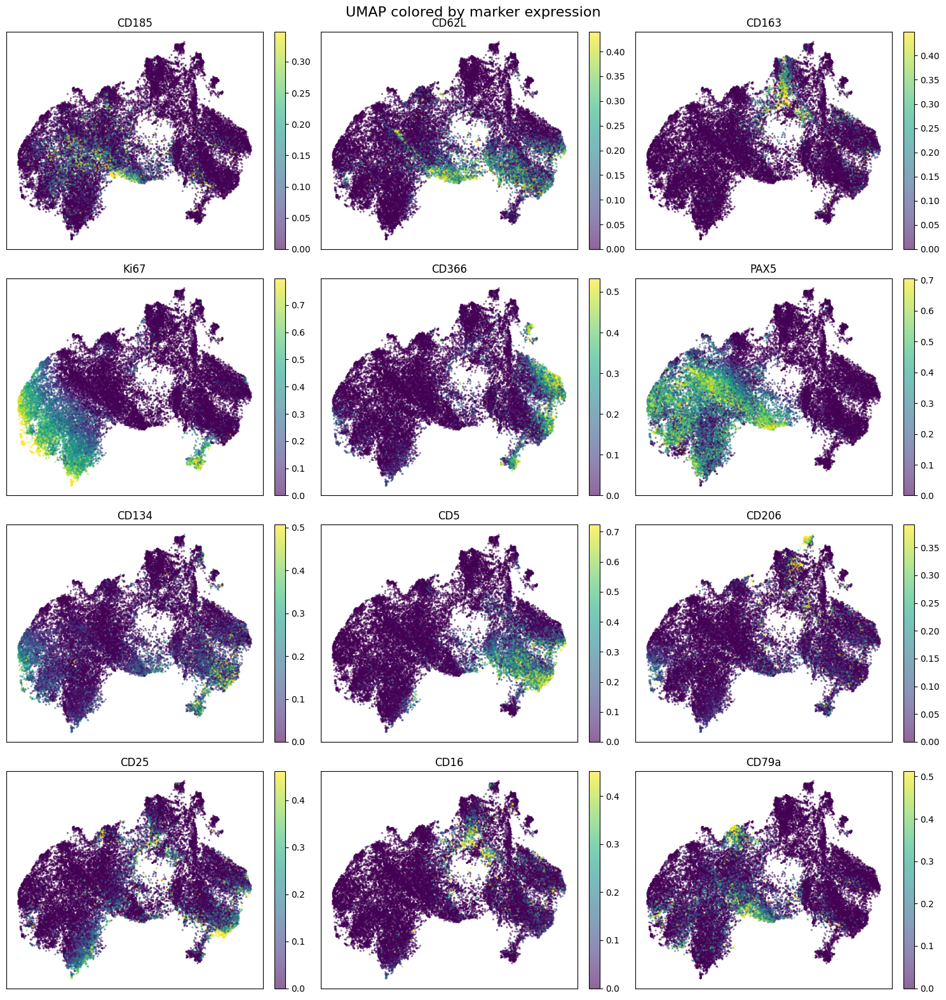


Available markers for coloring: ['CD185', 'CD62L', 'CD163', 'Ki67', 'CD366', 'PAX5', 'CD134', 'CD5', 'CD206', 'CD25', 'CD16', 'CD79a', 'CD34', 'CXCL13', 'CD21', 'CD7', 'Podoplanin', 'HLA-DR', 'CD223', 'CD20', 'CD56', 'CD45RO', 'CD278', 'CD90', 'CD4', 'CD11c', 'CD3', 'CD68', 'CD14', 'CD8', 'Kappa light chain', 'CD45RA', 'CD11b', 'Granzyme B', 'CD31', 'CD45', 'CD38', 'CD44', 'DRAQ5', 'DNA']


In [44]:
# 3. Interactive: plot all markers in a grid
def plot_all_markers_grid(max_markers=12, n_cols=3):
    """Plot UMAP colored by each marker in a grid"""
    marker_cols = [c for c in df.columns if c not in ['UMAP1', 'UMAP2', 'sid']]
    n_markers = min(len(marker_cols), max_markers)
    n_rows = (n_markers + n_cols - 1) // n_cols
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(5*n_cols, 4*n_rows))
    axes = axes.flatten() if n_markers > 1 else [axes]
    
    for idx, marker in enumerate(marker_cols[:n_markers]):
        ax = axes[idx]
        scatter = ax.scatter(df['UMAP1'], df['UMAP2'], c=df[marker], 
                           cmap='viridis', alpha=0.6, s=5, edgecolors='none', vmin=0, vmax=np.percentile(df[marker], 99))
        ax.set_title(marker)
        ax.set_xticks([])
        ax.set_yticks([])
        plt.colorbar(scatter, ax=ax, fraction=0.046, pad=0.04)
    
    # Hide unused subplots
    for idx in range(n_markers, len(axes)):
        axes[idx].axis('off')
    
    plt.suptitle('UMAP colored by marker expression', fontsize=16)
    plt.tight_layout()
    #plt.savefig('umap_all_markers.png', dpi=150, bbox_inches='tight')
    plt.show()

# Run grid plot for first 12 markers
plot_all_markers_grid(max_markers=12)

# Print available markers for reference
print(f"\nAvailable markers for coloring: {marker_names_filtered}")

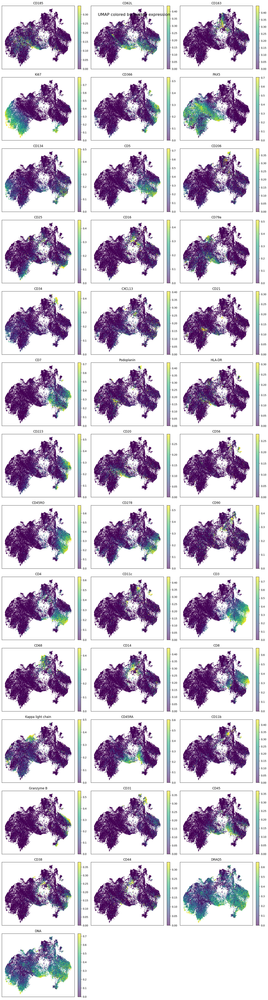

In [45]:
plot_all_markers_grid(max_markers=40)

[array([[[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         ...,
         [1.17494469e-03, 1.70901045e-03, 2.44144350e-04, ...,
          3.00068666e-01, 1.42748150e-01, 2.89158465e-02],
         [1.83108263e-04, 1.98367285e-04, 6.10360876e-05, ...,
          1.07576104e-01, 5.80605783e-02, 1.60372320e-02],
         [7.62951095e-05, 3.05180438e-05, 3.05180438e-05, ...,
          6.91233692e-02, 2.42008087e-02, 9.10963607e-03]],
 
        [[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       

In [78]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
from umap import UMAP
import pandas as pd
from BioUtensils_package.BioUtensils.extraction import get_cell_expression_fast

# Load data (your existing code)
h5_filepath = '/home/simon_g/isilon_images_mnt/10_MetaSystems/MetaSystemsData/_simon/data/MCI_data/h5_files/CODEX_DLBCL2/CODEX_DLBCL2_with_norm_stats.h5'

with h5py.File(h5_filepath, 'r') as h5f:
    
    sids = {sid: dict() for sid in np.sort(h5f['sample_ids'][()].astype(str))}
    sample_ids = h5f['coords']['sample_id'][()].astype(str)
    DIM1 = h5f['coords']['DIM1'][()]
    DIM2 = h5f['coords']['DIM2'][()]
    annotations = h5f['annotation'][()].astype(str)

    for sid in sids:
        W,H,C = h5f['data'][sid]['image'].shape
        masks = h5f['data'][sid]['masks'][()]
        print(masks.shape, DIM1.max(), DIM2.max())
        sids[sid]['masks'] = masks
        sids[sid]['DIM1'] = DIM1[sample_ids == sid]
        sids[sid]['DIM2'] = DIM2[sample_ids == sid]
        sids[sid]['annotations'] = annotations[sample_ids == sid]

(3750, 4998) 3742 4990
(3750, 4998) 3742 4990
(3750, 4998) 3742 4990
(3750, 4998) 3742 4990


In [80]:
color_map = {
    # B cells
    'B': '#1f77b4',        # blue
    'PC': '#aec7e8',       # light blue

    # T cells
    'CD4T': '#ff7f0e',     # orange-red
    'CD4TNaive': '#ffbb78',# light orange
    'TFH': '#d62728',      # red
    'TPR': '#ff9896',      # pink
    'TTOX': '#c49c94',     # muted red
    'TTOXNaive': '#f7b6d2',# pinkish
    'TTOX_exh': '#e377c2', # magenta
    'Treg': '#f7b6d2',     # pale pink

    # Dendritic cells
    'DC': '#9467bd',       # purple
    'FDC': '#c5b0d5',      # light purple

    # NK and myeloid cells
    'Granulo': '#2ca02c',  # green
    'MC': '#98df8a',       # light green
    'Macro': '#17becf',    # cyan/teal
    'NK': '#8c564b',       # brownish green
    'NKT': '#c49c94',      # muted brown

    # Stromal
    'Stromal cells': '#bcbd22', # yellow-green

    # Unknown
    'na': '#7f7f7f'        # gray
}

Cell Type          Count   Percentage
-------------------------------------
B                  60652       44.13%
TTOX_exh           13217        9.62%
Macro              12286        8.94%
CD4T                8863        6.45%
Treg                8359        6.08%
na                  7317        5.32%
TTOX                6808        4.95%
Stromal cells       4701        3.42%
TTOXNaive           4265        3.10%
TPR                 2798        2.04%
DC                  2283        1.66%
CD4TNaive           1560        1.14%
TFH                 1306        0.95%
FDC                  939        0.68%
NK                   797        0.58%
NKT                  558        0.41%
PC                   431        0.31%
MC                   188        0.14%
Granulo              112        0.08%
-------------------------------------
Total             137440      100.00%


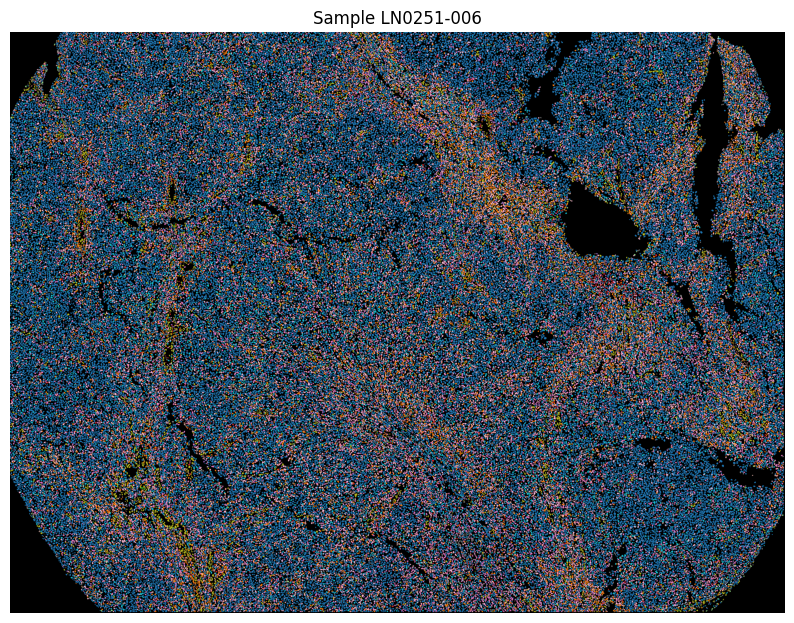

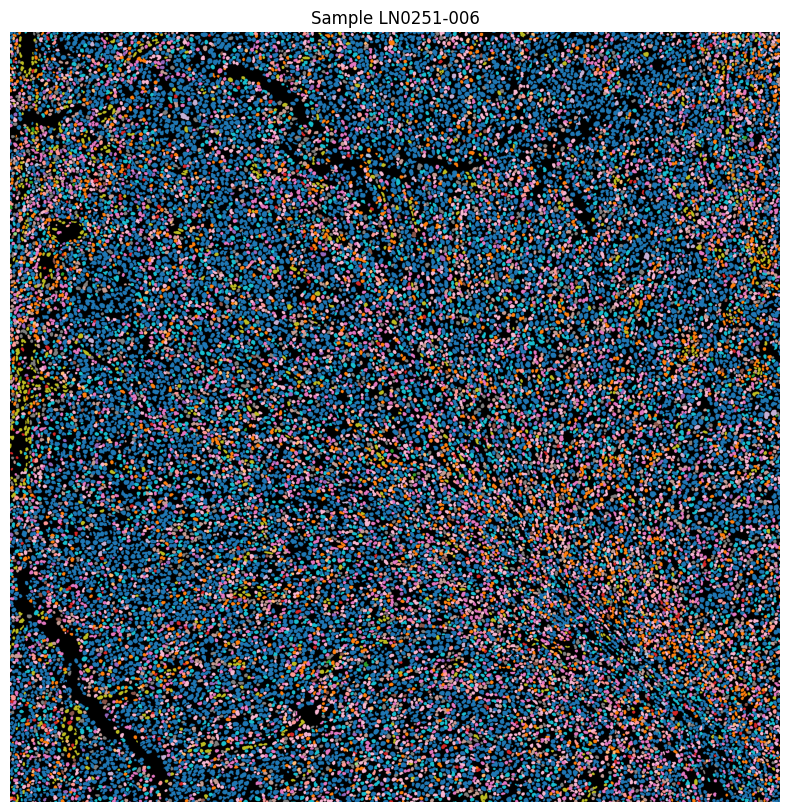

Cell Type          Count   Percentage
-------------------------------------
B                  65478       47.04%
TTOX_exh           12957        9.31%
CD4T                9306        6.69%
Macro               8930        6.42%
na                  7947        5.71%
Treg                7403        5.32%
TTOXNaive           5013        3.60%
Stromal cells       4981        3.58%
TTOX                4755        3.42%
DC                  3350        2.41%
CD4TNaive           2319        1.67%
TPR                 2181        1.57%
TFH                 1255        0.90%
FDC                 1129        0.81%
NK                   892        0.64%
NKT                  729        0.52%
PC                   340        0.24%
Granulo              127        0.09%
MC                    91        0.07%
-------------------------------------
Total             139183      100.00%


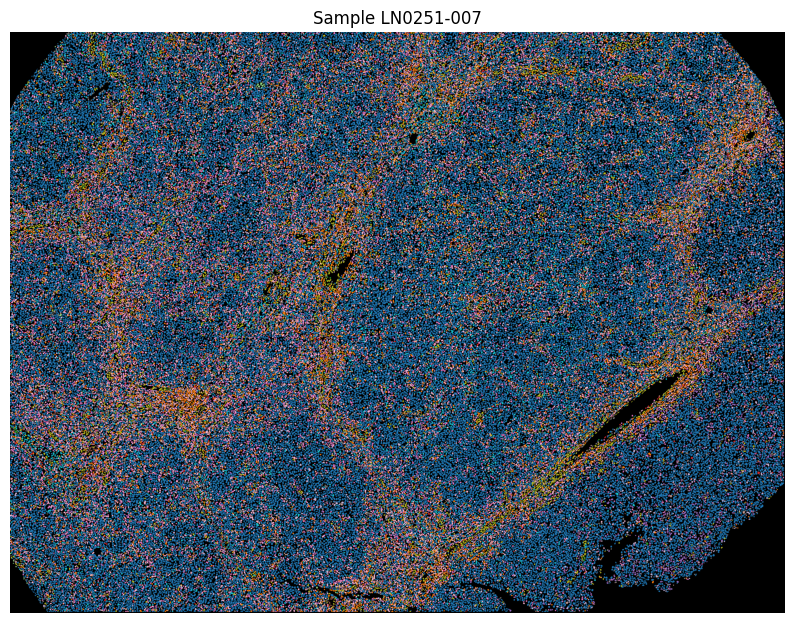

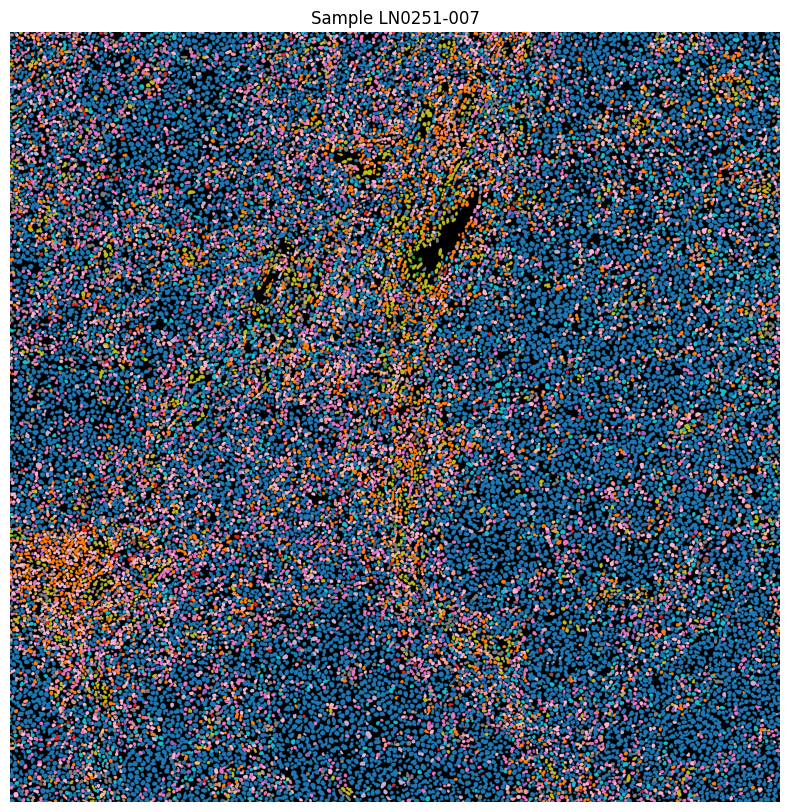

Cell Type          Count   Percentage
-------------------------------------
B                  67137       46.91%
Macro              18325       12.80%
Stromal cells      15512       10.84%
na                  7933        5.54%
CD4T                7852        5.49%
TTOX_exh            5407        3.78%
Treg                4300        3.00%
TTOX                3638        2.54%
DC                  3617        2.53%
TFH                 2240        1.57%
TPR                 2230        1.56%
FDC                 2173        1.52%
TTOXNaive           1069        0.75%
NK                   757        0.53%
CD4TNaive            506        0.35%
PC                   167        0.12%
MC                   107        0.07%
Granulo              102        0.07%
NKT                   50        0.03%
-------------------------------------
Total             143122      100.00%


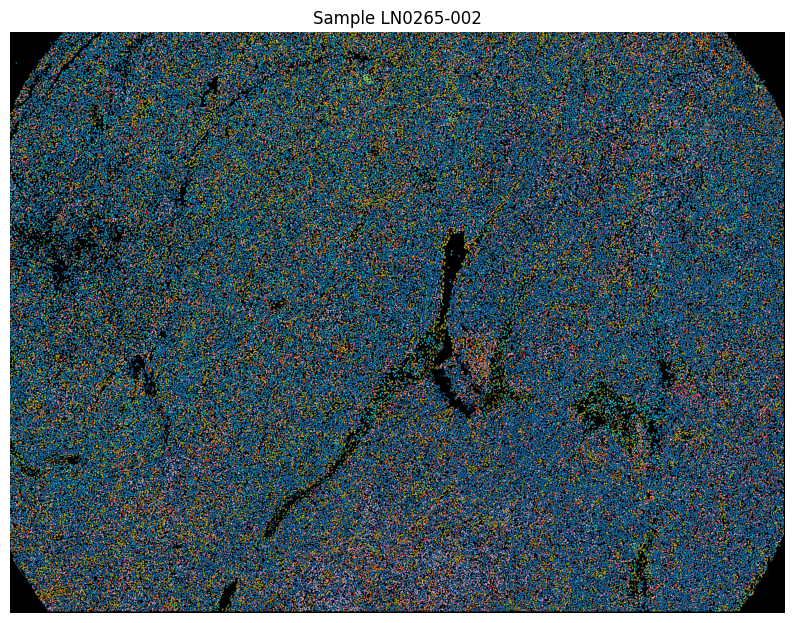

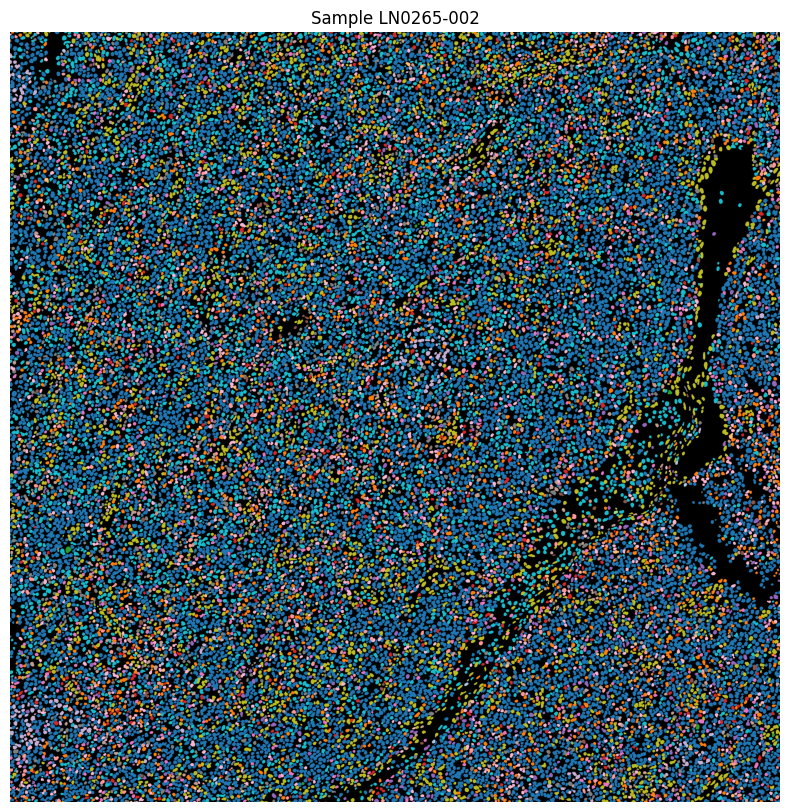

Cell Type          Count   Percentage
-------------------------------------
B                  80943       62.69%
Stromal cells      13490       10.45%
DC                  8452        6.55%
na                  5242        4.06%
CD4T                4809        3.72%
FDC                 3513        2.72%
TTOX                2746        2.13%
Treg                2393        1.85%
Macro               2070        1.60%
TTOX_exh            1644        1.27%
TPR                 1121        0.87%
TFH                 1119        0.87%
NK                   680        0.53%
TTOXNaive            449        0.35%
CD4TNaive            144        0.11%
PC                   129        0.10%
Granulo              108        0.08%
MC                    53        0.04%
NKT                   12        0.01%
-------------------------------------
Total             129117      100.00%


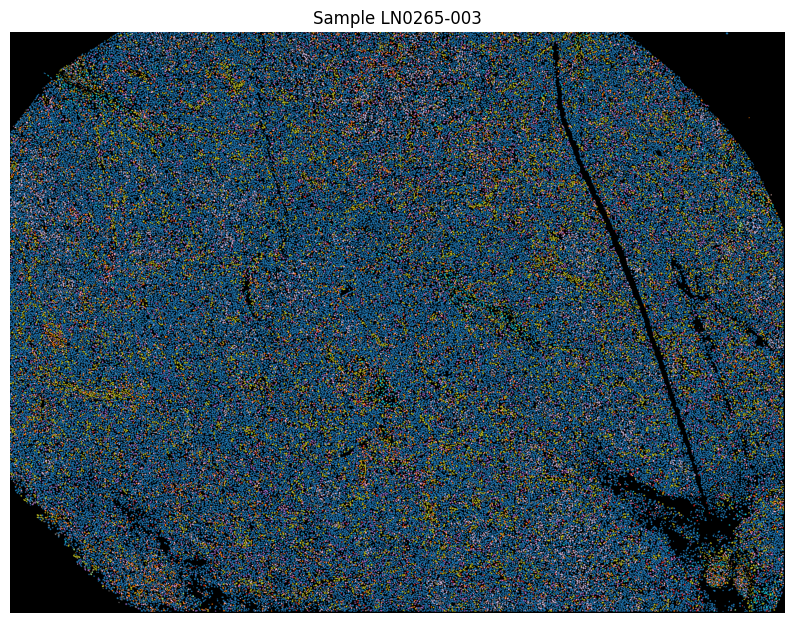

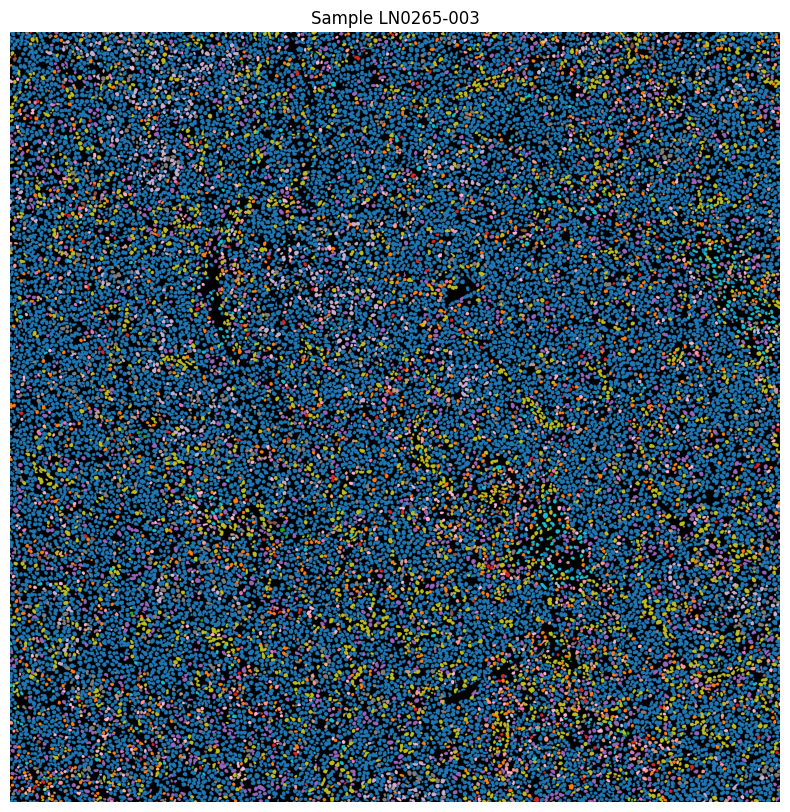

In [93]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors
from collections import Counter

for sid, values in sids.items():
    
    DIM1 = values['DIM1']    
    DIM2 = values['DIM2']

    mask_ids = values['masks'][DIM1, DIM2]

    # Create color mapping for each mask ID
    colors = np.zeros((values['masks'].max() + 1, 3))  # RGB float array 0-1

    # Assign colors from your color_map
    for mask_id, celltype in zip(mask_ids, values['annotations']):
        hex_color = color_map.get(celltype, '#000000')  # fallback to black
        rgb = np.array(mcolors.to_rgb(hex_color))  # convert hex to RGB floats
        colors[mask_id] = rgb
        
    
    # Count each cell type
    celltype_counts = Counter(values['annotations'])
    total_cells = sum(celltype_counts.values())

    # Print header
    print(f"{'Cell Type':<15} {'Count':>8} {'Percentage':>12}")
    print("-" * 37)

    # Print each cell type with count and percentage
    for celltype, count in celltype_counts.most_common():
        percentage = (count / total_cells) * 100
        print(f"{celltype:<15} {count:>8} {percentage:>11.2f}%")

    # Print total
    print("-" * 37)
    print(f"{'Total':<15} {total_cells:>8} {100:>11.2f}%")
        
    # Ensure background (ID=0) is black
    colors[0] = [0, 0, 0]

    masks = values['masks']

    # Create RGB image by indexing
    rgb_image = colors[masks]

    plt.figure(figsize=(10,10))
    plt.imshow(rgb_image)
    plt.title(f"Sample {sid}")
    plt.axis('off')
    plt.show()
    
    plt.figure(figsize=(10,10))
    plt.imshow(rgb_image[1000:3000, 1000:3000])
    plt.title(f"Sample {sid}")
    plt.axis('off')
    plt.show()